In [17]:
import pandas as pd
import rdkit.Chem.PandasTools as pt
from matplotlib.pyplot import plot as plt
import seaborn as sns
import numpy as np

from rdkit import Chem
from rdkit.Chem import AllChem
from usrcat.toolkits.rd import generate_moments
from usrcat.sim import *
from rdkit.Chem import PandasTools as pt
import pandas as pd
import numpy as np
import sys

In [85]:
ltkb = pd.read_csv("../lktb_inchis.csv")
print(ltkb.shape)
ltkb.head()

(1036, 20)


,LTKB_ID,COMPOUND_NAME,MOL_FORMULA,SIMILARITY,CASN,DRUGBANK_ID,ATC_CODE,VERIFIED_DILI_CONCERN,DILI_CONCERN,LABEL_SECTION,SEVERITY_CLASS,DILI_DESCRIPTION,GREENE_ANNOTATION,XU_ANNOTATION,OBRIEN_ANNOTATION,SUZUKI_ANNOTATION,GUO_ANNOTATION,SAKATIS_ANNOTATION,VER_DISP,InChI
0,3,mercaptopurine,C5 H4 N4 S,NaN,50-44-2,DB01033,L01BB02,vMost-DILI-Concern,Most-DILI-Concern,Warnings and precautions,8.0,Hepatotoxicity: A small number of deaths have been reported that may have been attributed to hepatic necrosis,HH,Positive,Severely,2.0,3.0,Hepatotoxic,1,"InChI=1/C5H4N4S/c10-5-3-4(7-1-6-3)8-2-9-5/h1-2H,(H2,6,7,8,9,10)/f/h6,8H"
1,4,acetaminophen,C8 H9 N O2,NaN,103-90-2,DB00316,N02BE01,vMost-DILI-Concern,Most-DILI-Concern,Warnings and precautions,5.0,Severe liver damage may occur if you take ¦ more than 8 tablets in 24 hours,HH,Positive,Severely,2.0,3.0,Hepatotoxic,2,"InChI=1/C8H9NO2/c1-6(10)9-7-2-4-8(11)5-3-7/h2-5,11H,1H3,(H,9,10)/f/h9H"
2,6,azathioprine,C9 H7 N7 O2 S,NaN,446-86-6 55774-33-9,DB00993,L04AX01,vMost-DILI-Concern,Most-DILI-Concern,Warnings and precautions,5.0,"These symptoms may also be accompanied by diarrhea, rash, fever, malaise, myalgias, elevations in liver enzymes, and occasionally, hypotension.",HH,Positive,Moderately,1.0,3.0,Hepatotoxic,1,"InChI=1/C9H7N7O2S/c1-15-4-14-7(16(17)18)9(15)19-8-5-6(11-2-10-5)12-3-13-8/h2-4H,1H3,(H,10,11,12,13)/f/h10H"
3,9,chlorpheniramine,C16 H19 Cl N2,NaN,132-22-9,DB01114,R06AB04,vNo-DILI-Concern,No-DILI-Concern,No match,0.0,NaN,HH,Positive,NaN,NaN,NaN,NaN,2,"InChI=1/C16H19ClN2/c1-19(2)12-10-15(16-5-3-4-11-18-16)13-6-8-14(17)9-7-13/h3-9,11,15H,10,12H2,1-2H3"
4,11,clofibrate,C12 H15 Cl O3,NaN,637-07-0,DB00636,C10AB01,vLess-DILI-Concern,Less-DILI-Concern,Warnings and precautions,3.0,Liver-function tests abnormal,HH,NaN,Moderately,NaN,NaN,non-hepatotixic,1,"InChI=1/C12H15ClO3/c1-4-15-11(14)12(2,3)16-10-7-5-9(13)6-8-10/h5-8H,4H2,1-3H3"


In [30]:
# Map severity classes to strings

ltkb["SEVERITY_CLASS"] = ltkb["SEVERITY_CLASS"].map( {0:'0', 1:'1', 2:'2', 3:'3', 4:'4', 5: '5', 6 :'6', 7:'7', 8:'8'})


In [31]:
# Split ATCs to subcodes

ltkb["ATC_CODE"] = ltkb["ATC_CODE"].fillna("-")
ATCs = ltkb["ATC_CODE"]

atc_1 = []
atc_2 = []
atc_3 = []
atc_4 = []
atc_5 = []


for el in ATCs.tolist():
    try:
        el = el.split(" ")[0]
        if len(el) == 7:
            atc_1.append(el[0])
            atc_2.append(el[0:3])
            atc_3.append(el[0:4])
            atc_4.append(el[0:5])
            atc_5.append(el[0:7])
        else:
            atc_1.append("-")
            atc_2.append("-")
            atc_3.append("-")
            atc_4.append("-")
            atc_5.append("-")            

    except:
        print (el)
        atc_1.append("-")
        atc_2.append("-")
        atc_3.append("-")
        atc_4.append("-")
        atc_5.append("-")

ltkb["ATC_1"] = atc_1
ltkb["ATC_2"] = atc_2
ltkb["ATC_3"] = atc_3
ltkb["ATC_4"] = atc_4
ltkb["ATC_5"] = atc_5

In [32]:
ltkb.shape

(1036, 25)

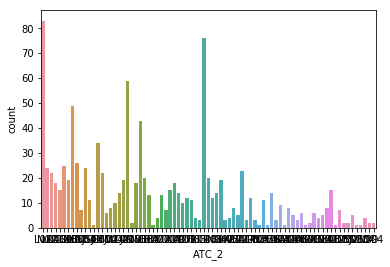

In [33]:
sns.countplot(x=ltkb["ATC_2"])

In [34]:
# Let's get the tag availability for the database

n_entries = []
for col in ltkb.columns:
    n_entries.append(ltkb[col].describe()["count"])
    
n_entries = np.asarray(n_entries).reshape(1, -1)
n_entries = pd.DataFrame(n_entries, columns=ltkb.columns.tolist())
n_entries

(1036, 25)


,LTKB_ID,COMPOUND_NAME,MOL_FORMULA,SIMILARITY,CASN,DRUGBANK_ID,ATC_CODE,VERIFIED_DILI_CONCERN,DILI_CONCERN,LABEL_SECTION,...,SUZUKI_ANNOTATION,GUO_ANNOTATION,SAKATIS_ANNOTATION,VER_DISP,InChI,ATC_1,ATC_2,ATC_3,ATC_4,ATC_5
0,1036.0,1036.0,907.0,0.0,1001.0,841.0,1036.0,935.0,935.0,935.0,...,268.0,144.0,177.0,1036.0,982.0,1036.0,1036.0,1036.0,1036.0,1036.0


In [36]:
# Let's remove compounds with no InChI

ltkb = ltkb.fillna("-")
ltkb = ltkb[ltkb["InChI"] !="-"]
ltkb.shape

(957, 25)

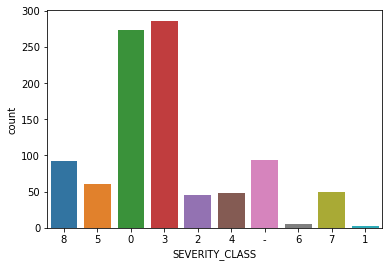

In [39]:
# Countplot of different severity_class tag

sns.countplot(ltkb["SEVERITY_CLASS"])

In [41]:
# Compute USR-CAT moments

def get_moments(mols):
    matrix = np.zeros((len(mols), 600))
    for index, mol in enumerate(mols):
        try:
            vector = np.ravel(generate_moments(mol))
            matrix[index, :] = vector
        except:
            sys.exit(-1)
    return matrix

In [42]:
# Get mols from InChIs

ltkb["ROMol"] = [AllChem.MolFromInchi(i) for i in ltkb["InChI"]]

In [44]:
# Get conformations for compounds
errors = []
for index, row in ltkb.iterrows():
    try:
        AllChem.EmbedMultipleConfs(row["ROMol"], numConfs=10)
    except:
        print ("error at index ", index)
        errors.append(index)
        
        

error at index  42
error at index  329
error at index  336
error at index  345
error at index  353
error at index  358
error at index  374
error at index  486
error at index  504
error at index  687
error at index  787
error at index  789
error at index  938
error at index  945
error at index  978
error at index  1015
error at index  1022
error at index  1030


In [46]:
# Get subframe with no erroneus compounds at computing conformers 

ltkb_1 = ltkb[~ltkb.index.isin(errors)].reset_index(drop=True)
erroneus = []
for index, row in ltkb_1.iterrows():
    if len(row["ROMol"].GetConformers()) != 10:
        erroneus.append(index)
ltkb_1 = ltkb_1[~ltkb_1.index.isin(erroneus)].reset_index(drop=True)

In [48]:
# Get USR-CAT moments

matrix = get_moments(ltkb_1["ROMol"].tolist())
dili = pd.DataFrame(matrix)

In [51]:
# Now let's cluster ltkb compounds by their 3D-shape/pharmacophoric properties

from sklearn.cluster import KMeans

km = KMeans(n_clusters=30, random_state=46)
km.fit(matrix)
ltkb_1["cluster"] = km.labels_
mols = ltkb_1["ROMol"].tolist()

# Save the file to open it again with PandasTool (to see molecule depiction)
pt.WriteSDF(ltkb_1, "dili_cluster3d.sdf", properties=ltkb_1.columns)
ltkb_1 = pt.LoadSDF("dili_cluster3d.sdf")

/home/jcgomez/anaconda3/envs/flame/lib/python3.6/site-packages/rdkit/Chem/PandasTools.py:410: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if np.issubdtype(type(cell_value), float):


In [56]:
# Convert the cluster column to integer

ltkb_1["cluster"] = ltkb_1["cluster"].astype(int)

In [57]:
ltkb_bk = ltkb_1.copy()
new = ltkb_bk.copy()

In [61]:
new["cluster2"] = ""
for cluster in np.unique(new["cluster"]):
    subset = new[new["cluster"] == cluster]
    morgans = [AllChem.GetMorganFingerprintAsBitVect(mol, 2, useFeatures=False) for mol in subset["ROMol"]]
    if len(morgans) > 10:
        #n_clu = int(len(morgans) * 0.2)
        n_clu = 5
        km = KMeans(n_clusters=n_clu, random_state=46)
        km.fit(morgans)
        subset["cluster2"] = km.labels_
        for index, row in subset.iterrows():
            new.at[index, "cluster2"] = row["cluster2"]
        
    else:
        continue
    

/home/jcgomez/anaconda3/envs/flame/lib/python3.6/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [62]:
import matplotlib.pyplot as plt


In [83]:
len(np.unique(new["ATC_2"]))

72

In [63]:
new = new.sort_values(by=["cluster", "cluster2"])

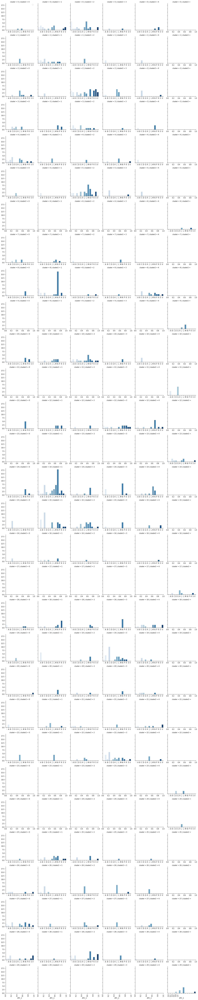

In [84]:
# Now let's plot the distribution among ATCs for clustered compounds.
    
most = new[new["VERIFIED_DILI_CONCERN"] == "vMost-DILI-Concern"]
no = new[new["VERIFIED_DILI_CONCERN"] == "vNo-DILI-Concern"]

grid = sns.FacetGrid(new[["cluster", "cluster2","VERIFIED_DILI_CONCERN", "ATC_1"]], 
                     col="cluster2", row="cluster",
                     size=3, aspect=1, legend_out=False, sharex=False)


# Draw a horizontal line to show the starting point

# Draw a line plot to show the trajectory of each random walk
fig = grid.map(sns.countplot, "ATC_1", palette="Blues",
               order=np.unique(new["ATC_1"]))

fig.set_xticklabels(rotation=90)
fig.add_legend()
fig.savefig("ltkb_facetGrid_clusters_ATCs.png",dpi=50)

,ROMol,cluster,cluster2,ATC_CODE,SEVERITY_CLASS
0,,0,0,L01BB02,8
260,,0,0,H03BB02,8
32,,0,1,L01XA02,3
52,,0,1,L01XX05,8
62,,0,1,A10BA02,0
95,,0,1,J04AK01,3
121,,0,1,B05BB03 B05XX02,6
177,,0,1,-,0
222,,0,1,V03AE03,0
324,,0,1,V04CG03,0

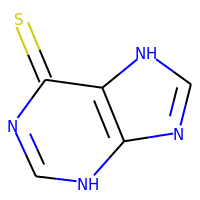
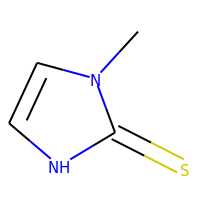
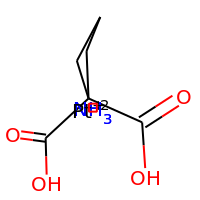
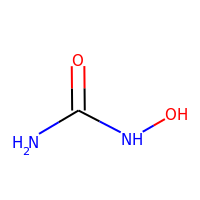
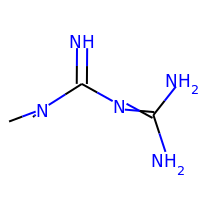
...
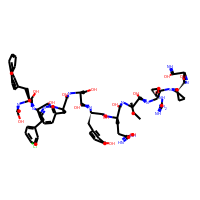
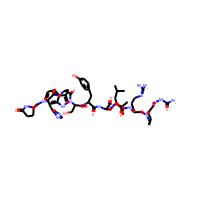
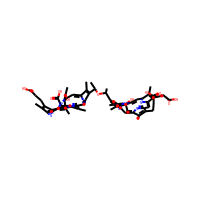
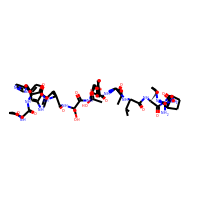
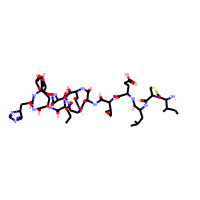

In [65]:
new.sort_values(by=["cluster", "cluster2"])[["ROMol", "cluster", "cluster2","ATC_CODE", "SEVERITY_CLASS"]]

In [110]:
new2 = new.copy(deep=True)

In [114]:
new2["SEVERITY_CLASS"] = new2["SEVERITY_CLASS"].replace("-", 0).astype(int)
new2["SEVERITY_CLASS"] = new2["SEVERITY_CLASS"].replace(0, np.nan)

In [87]:
grouped = new2.groupby(by=["cluster","cluster2", "ATC_1"])["SEVERITY_CLASS"].apply(list).reset_index()

NameError: name 'new2' is not defined

In [88]:
#grouped